In [1]:
import pandas as pd
from bertopic import BERTopic
from bertopic.representation import KeyBERTInspired
from umap import UMAP
import plotly.express as px
import itertools
import rapidfuzz
import numpy as np
from scipy.stats import pointbiserialr
import matplotlib.pyplot as plt
from sentence_transformers import SentenceTransformer
import spacy
import torch
import os
from wordcloud import WordCloud

from cuml import UMAP as cumlUMAP


In [2]:
pd.set_option('display.max_columns', None)
pd.set_option('display.width', 10000)

# 1. Analiza DF niezaanotowanego


In [3]:
df_sejm = pd.read_pickle('./bertopic_data/sejm_senat_no_anotation.pkl')
df_sejm.author = df_sejm.author.str.strip()

In [4]:
df_sejm

,date,author,text_all,place,TextBlob_Subjectivity,TextBlob_Polarity,sentiment_herbert,openai_result,text_part,sentiment,topic
0,2019-11-12,prezydent rzeczypospolitej polskiej andrzej duda,drodzy rodacy! wielce szanowny panie marszałku...,sejm,0.0000,0.0000,1,NaN,NaN,NaN,NaN
1,2019-11-12,senior antoni macierewicz,bardzo dziękuję panu prezydentowi za tak istot...,sejm,0.0625,-0.0625,1,NaN,NaN,NaN,NaN
2,2019-11-12,antoni macierewicz,tak mi dopomóż bóg.,sejm,0.0000,0.0000,1,NaN,NaN,NaN,NaN
3,2019-11-12,daniel milewski,poseł antoni macierewicz. dziękuję bardzo. pro...,sejm,0.0000,0.0000,1,NaN,NaN,NaN,NaN
4,2019-11-12,anna siarkowska,ślubuję. tak mi dopomóż panie boże wszechmogąc...,sejm,0.0000,0.0000,1,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...
1763481,2020-02-06,tomasz grodzki,"panie senatorze, 5 minut.",senat,0.0000,0.0000,0,NaN,NaN,NaN,NaN
1763482,2020-02-06,jerzy czerwiński,kończę myśl. …a następnie o zapewnienie finans...,senat,0.0000,0.0000,0,NaN,NaN,NaN,NaN
1763483,2020-02-06,tomasz grodzki,dziękuję bardzo. oświadczenie wygłosi pan sena...,senat,0.0000,0.0000,1,NaN,NaN,NaN,NaN
1763484,2020-02-06,marcin bosacki,"dziękuję bardzo, panie marszałku. swoje oświad...",senat,0.5000,0.5000,1,NaN,NaN,NaN,NaN


In [5]:
print('Unique places:')
print(df_sejm.place.unique())

Unique places:
['sejm' 'senat']


In [6]:
speeches_per_day = df_sejm.date.value_counts().reset_index().sort_values(by='index').set_index('index')
speeches_per_day = speeches_per_day.rename(columns={'date': 'count'})

date_range = pd.date_range(start=speeches_per_day.index.min(), end=speeches_per_day.index.max(), freq='D')

df_reindexed = speeches_per_day.reindex(date_range, fill_value=0)

window_size = 50
df_reindexed['MA'] = df_reindexed['count'].rolling(window=window_size).mean()
px.line(df_reindexed, x=df_reindexed.index, y=['count', 'MA'], title='Speeches in sejm and senat over time')


Obserwacje:

1. Widać zasadniczy skok w liczbie zarejestrowanych wypowiedzi sejmowych na przełomie grudnia 2015 i stycznia 2016
2. Wypowiedzi sejmowe są wygłaszane w określonych momentach, które wydają się odpowiadać terminom posiedzeń Sejmu (np. styczeń 2016)


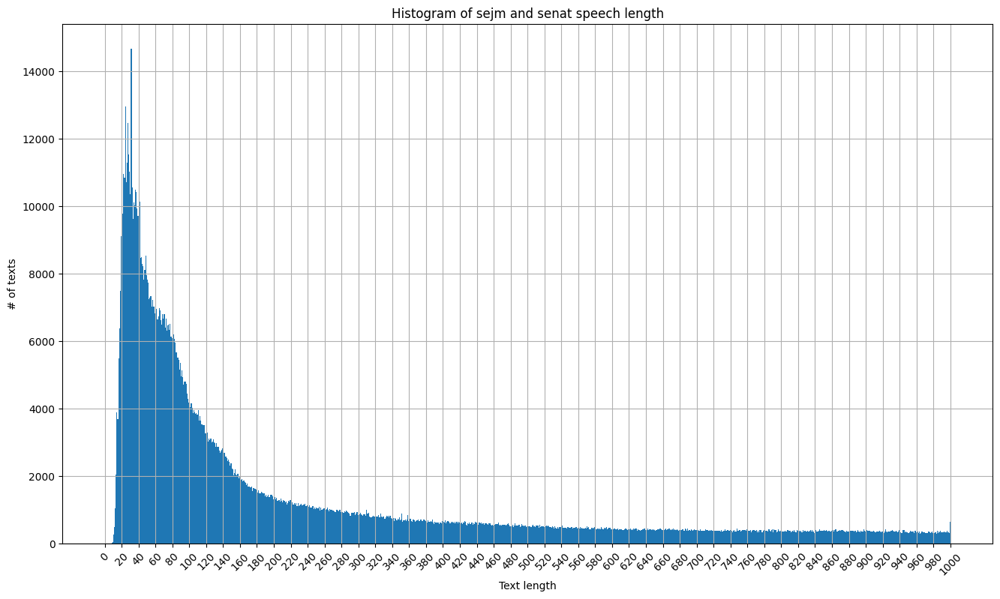

In [7]:
fig, ax = plt.subplots()
max_range=1000
df_sejm.text_all.str.len().hist(range=(0, max_range), bins=max_range, ax=ax)
ax.set_title('Histogram of sejm and senat speech length')
ax.set_ylabel('# of texts')
ax.set_xlabel('Text length')
ax.set_xticks(range(0, max_range+1, 20))
ax.set_xticklabels(range(0, max_range+1, 20), rotation=45)
fig.set_size_inches(16, 9)


In [8]:
text_all = df_sejm.text_all

def print_sample_texts_in_range(min_range = 20,max_range = 100):
    subset_of_n_length = text_all[(text_all.str.len() > min_range) & (text_all.str.len() <= max_range)]
    print(f'Sample of texts with length in range ({min_range}, {max_range}] ({len(subset_of_n_length)*100/len(text_all):.2f}%):\n')
    for text in subset_of_n_length.sample(40):
        print(text)

print_sample_texts_in_range(0, 150)
print()
print_sample_texts_in_range(100, 200)
print()
print_sample_texts_in_range(200, 1000)
print()
print_sample_texts_in_range(1000, 10000)
print()
print_sample_texts_in_range(10000, 100000)

Sample of texts with length in range (0, 150] (47.03%):

dziękuję bardzo. jeszcze pan dyrektor cichomski. proszę bardzo.
szanowni państwo, moja wypowiedź będzie krótka. przychylamy się do uwagi i do propozycji biura legislacyjnego.
(pan ma nieaktualną wiedzę.)
(dzień świętego józefa.)
oczywiście, proszę bardzo.
dziękuję, pani minister. pan poseł gadzinowski, proszę.
dziękuję bardzo, panie senatorze. bardzo proszę pana ministra o udzielenie odpowiedzi.
panie pośle, proszę już usiąść i pozwolić mi dokończyć wypowiedź. może pan wystąpić jako przedstawiciel wnioskodawców, ale nie w kwestii sprostowania.
dziękuję panu posłowi. głos ma pan poseł tadeusz tomaszewski, sojusz lewicy demokratycznej.
dziękuję panu posłowi. proszę bardzo, poseł sprawozdawca pragnie sprostować.
proszę bardzo, panie ministrze.
dziękuję bardzo. pan poseł krystian kamiński, konfederacja. przygotowuje się pani poseł małgorzata tracz.
dziękuję panu posłowi. proszę o zabranie głosu pana posła stanisława rogowskiego z uni

Obserwacje:

1. Można zauważyć, że teksty o długości do 150 znaków nie noszą informacji niemal w ogóle, na jaki temat są wygłaszane wypowiedzi i kwalifikują się do pominięcia
2. Te teksty stanowią niemal 50% całego zbioru danych


In [9]:
df_sejm.drop(df_sejm[df_sejm.text_all.str.len() <= 150].index, inplace=True)

In [10]:
df_sejm[df_sejm['date'] < pd.Timestamp('2007-11-05')] #first day of the 7th Sejm's term of office

,date,author,text_all,place,TextBlob_Subjectivity,TextBlob_Polarity,sentiment_herbert,openai_result,text_part,sentiment,topic
68927,1980-01-31,sylwester zawadzki,obywatelu marszałku! wysoki sejmie! już w pier...,sejm,0.000,0.00000,1,NaN,NaN,NaN,NaN
68929,1980-01-31,adam łopatka,obywatelu marszałku! wysoka izbo! jedną z naji...,sejm,0.125,-0.15625,1,NaN,NaN,NaN,NaN
68931,1980-01-31,edward duda,obywatelu marszałku! wysoki sejmie! wniesiony ...,sejm,0.000,0.00000,1,NaN,NaN,NaN,NaN
68933,1980-01-31,maria budzanowska,wysoki sejmie! obywatelu marszałku! projekt us...,sejm,0.000,0.00000,1,NaN,NaN,NaN,NaN
68935,1980-01-31,minister sprawiedliwości jerzy bafia,obywatelu marszałku! wysoka izbo! inicjatywa u...,sejm,0.000,0.00000,1,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...
1537785,2007-09-14,zbigniew trybuła,panie marszałku! panie i panowie senatorowie! ...,senat,0.000,0.00000,0,NaN,NaN,NaN,NaN
1537787,2007-09-14,stanisław piotrowicz,panie marszałku! wysoka izbo! oświadczenie swo...,senat,0.400,-0.20000,0,NaN,NaN,NaN,NaN
1537789,2007-09-14,stanisław piotrowicz,"oświadczenie kieruję do pana zbigniewa religi,...",senat,0.000,0.00000,0,NaN,NaN,NaN,NaN
1537791,2007-09-14,elżbieta rafalska,panie marszałku! swoje oświadczenie kieruję do...,senat,0.000,0.00000,0,NaN,NaN,NaN,NaN


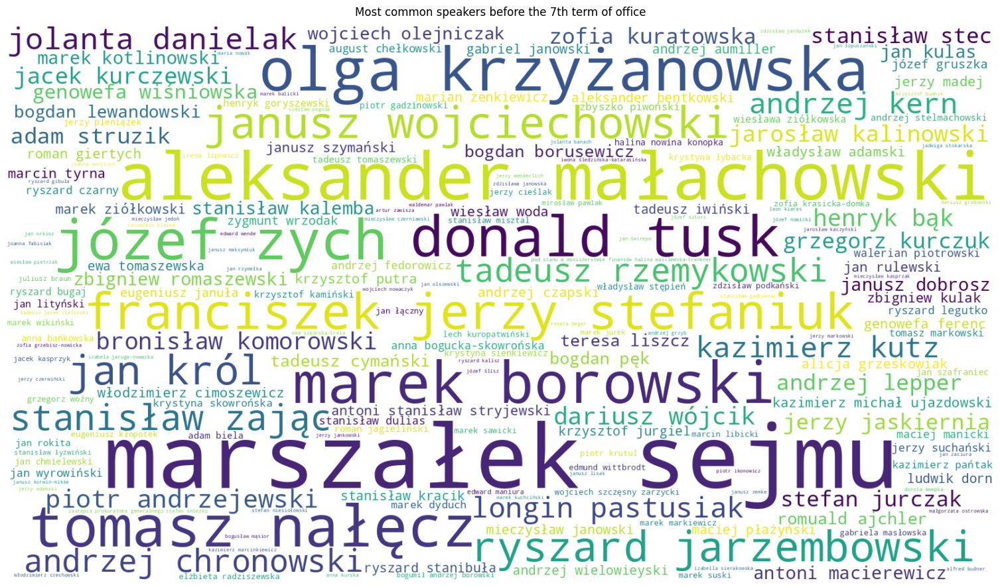

In [11]:
wc = WordCloud(width=1600, height=900, background_color='white', prefer_horizontal=1)

image = wc.generate_from_frequencies(
(df_sejm[df_sejm['date'] < pd.Timestamp('2007-11-05')].author.value_counts() / len(df_sejm[df_sejm['date'] < pd.Timestamp('2007-11-05')])).to_dict()

)

fig, ax = plt.subplots()
ax.imshow(image, interpolation='bilinear')
ax.axis('off')
fig.suptitle('Most common speakers before the 7th term of office')
fig.set_size_inches(16, 9)
fig.tight_layout()
fig.show()


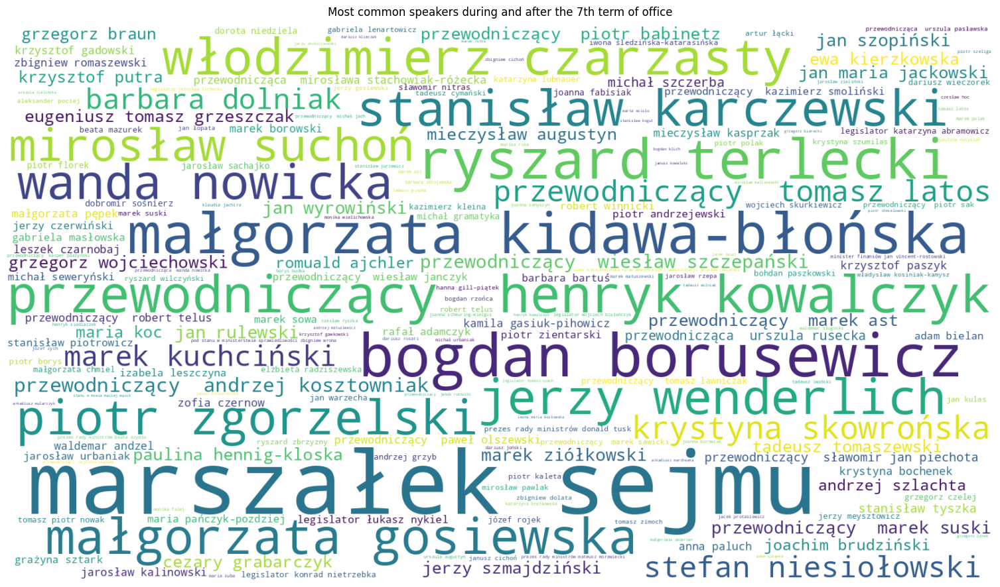

In [12]:
wc = WordCloud(width=1600, height=900, background_color='white', prefer_horizontal=1)

image = wc.generate_from_frequencies(
(df_sejm[df_sejm['date'] >= pd.Timestamp('2007-11-05')].author.value_counts() / len(df_sejm[df_sejm['date'] >= pd.Timestamp('2007-11-05')])).to_dict()

)

fig, ax = plt.subplots()
ax.imshow(image, interpolation='bilinear')
ax.axis('off')
fig.suptitle('Most common speakers during and after the 7th term of office')
fig.set_size_inches(16, 9)
fig.tight_layout()
fig.show()


Obserwacje:

1. Do rozpoczęcia 7. kadencji Sejmu rzadko wypowiadają się osoby, które są obecne teraz na scenie politycznej. Warto zatem ograniczyć zbiór wypowiedzi do 7. kadencji i w górę
2. Od rozpoczęcia 7. kadencji Sejmu i w górę mozna zauważyć znajome nazwiska


In [13]:
df_sejm.drop(df_sejm[df_sejm['date'] < pd.Timestamp('2007-11-05')].index, inplace=True)

In [14]:
print('Number of duplicates in df:', df_sejm.duplicated().sum())
df_sejm.drop_duplicates(inplace=True)

Number of duplicates in df: 70957


In [15]:
df_sejm

,date,author,text_all,place,TextBlob_Subjectivity,TextBlob_Polarity,sentiment_herbert,openai_result,text_part,sentiment,topic
0,2019-11-12,prezydent rzeczypospolitej polskiej andrzej duda,drodzy rodacy! wielce szanowny panie marszałku...,sejm,0.0000,0.0000,1,NaN,NaN,NaN,NaN
1,2019-11-12,senior antoni macierewicz,bardzo dziękuję panu prezydentowi za tak istot...,sejm,0.0625,-0.0625,1,NaN,NaN,NaN,NaN
3,2019-11-12,daniel milewski,poseł antoni macierewicz. dziękuję bardzo. pro...,sejm,0.0000,0.0000,1,NaN,NaN,NaN,NaN
27,2019-11-12,marzena machałek,dziękuję. panie marszałku! wysoka izbo! panie ...,sejm,0.0000,0.0000,1,NaN,NaN,NaN,NaN
28,2019-11-12,senior antoni macierewicz,"bardzo dziękuję, pani poseł. zanim przejdziemy...",sejm,0.0000,0.0000,0,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...
1763478,2020-02-06,beata małecka-libera,dziękuję bardzo. oświadczenie w sprawie wpisan...,senat,0.0000,0.0000,1,NaN,NaN,NaN,NaN
1763480,2020-02-06,jerzy czerwiński,panie marszałku! wysoka izbo! swoje dzisiejsze...,senat,0.0000,0.0000,0,NaN,NaN,NaN,NaN
1763482,2020-02-06,jerzy czerwiński,kończę myśl. …a następnie o zapewnienie finans...,senat,0.0000,0.0000,0,NaN,NaN,NaN,NaN
1763484,2020-02-06,marcin bosacki,"dziękuję bardzo, panie marszałku. swoje oświad...",senat,0.5000,0.5000,1,NaN,NaN,NaN,NaN


# 2. Przygotowanie modelu oraz wcześniejsze zaembedowanie tekstów sejmowych dla przyspieszenia prac


In [16]:
embedding_model='paraphrase-multilingual-MiniLM-L12-v2'
sentence_model = SentenceTransformer(embedding_model, device='cuda')
if not ('embeddings' in locals()):
    if (os.path.exists('./bertopic_results/sejm/sejm_text_embeddings.npy')):
        embeddings = np.load('./bertopic_results/sejm/sejm_text_embeddings.npy')
    else:
        embeddings: np.ndarray = sentence_model.encode(df_sejm.text_all.to_numpy(), show_progress_bar=True, batch_size=128)
        np.save('./bertopic_results/sejm/sejm_text_embeddings.npy', embeddings)

In [17]:
representation_model = KeyBERTInspired(random_state=42)
calculate_probabilities = True # get document's topic probs for each detected topic, not just the predicted one
umap_model = cumlUMAP(n_neighbors=30, n_components=5, min_dist=0.0, metric='cosine', random_state=42, verbose=True)

nr_topics: int | str = 100

if not os.path.exists('./bertopic_results/sejm/model/topic_embeddings.bin'):
    topic_model = BERTopic(embedding_model=embedding_model, nr_topics=nr_topics, verbose=True, representation_model=representation_model, calculate_probabilities=calculate_probabilities, umap_model=umap_model, low_memory=True)
    topics, probs = topic_model.fit_transform(df_sejm.text_all, embeddings=embeddings)
    topic_model.save('./bertopic_results/sejm/model', serialization="pytorch", save_ctfidf=True)
else:
    topic_model = BERTopic.load('./bertopic_results/sejm/model')
    topics, probs = topic_model.transform(df_sejm.text_all, embeddings=embeddings)

2023-12-26 21:04:47,100 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm


[D] [21:04:47.524944] /__w/cuml/cuml/cpp/src/umap/runner.cuh:108 n_neighbors=30
[D] [21:04:47.525337] /__w/cuml/cuml/cpp/src/umap/runner.cuh:130 Calling knn graph run
[D] [21:05:04.679101] /__w/cuml/cuml/cpp/src/umap/runner.cuh:136 Done. Calling fuzzy simplicial set
[D] [21:05:04.693181] /__w/cuml/cuml/cpp/src/umap/fuzzy_simpl_set/naive.cuh:317 Smooth kNN Distances
[D] [21:05:04.693409] /__w/cuml/cuml/cpp/src/umap/fuzzy_simpl_set/naive.cuh:319 sigmas = [ 0.117835, 0.0116647, 0.00601195, 0.012843, 0.0866346, 0.104264, 0.0190977, 0.0283303, 0.0197855, 0.026695, 0.00393993, 0.0227883, 0.0191439, 0.0139319, 0.04477, 0.0392603, 0.0713081, 0.0544086, 0.00596254, 0.0846138, 0.0157168, 0.101407, 0.0197585, 0.00998428, 0.0687878 ]

[D] [21:05:04.693425] /__w/cuml/cuml/cpp/src/umap/fuzzy_simpl_set/naive.cuh:321 rhos = [ 2.38419e-07, 0.116991, 0.16776, 0.119388, 3.57628e-07, 2.98023e-07, 0.216008, 0.128849, 0.0780719, 0.176417, 0.1196, 0.180633, 0.23649, 0.118947, 0.100395, 0.100395, 5.96046e-08,

2023-12-26 21:05:32,966 - BERTopic - Dimensionality - Completed ✓
2023-12-26 21:05:32,971 - BERTopic - Cluster - Start clustering the reduced embeddings


[D] [21:05:32.816190] /__w/cuml/cuml/cpp/src/umap/runner.cuh:382 Smoothing KNN distances
[D] [21:05:32.824559] /__w/cuml/cuml/cpp/src/umap/runner.cuh:414 Executing fuzzy simplicial set
[D] [21:05:32.831713] /__w/cuml/cuml/cpp/src/umap/runner.cuh:443 Performing L1 normalization
[D] [21:05:32.851922] /__w/cuml/cuml/cpp/src/umap/runner.cuh:479 n_epochs=30
[D] [21:05:32.860896] /__w/cuml/cuml/cpp/src/umap/runner.cuh:502 Computing # of epochs for training each sample
[D] [21:05:32.861087] /__w/cuml/cuml/cpp/src/umap/runner.cuh:509 Performing optimization


2023-12-27 00:34:34,666 - BERTopic - Cluster - Completed ✓
2023-12-27 00:34:34,671 - BERTopic - Representation - Extracting topics from clusters using representation models.
2023-12-27 00:36:06,121 - BERTopic - Representation - Completed ✓
2023-12-27 00:36:06,161 - BERTopic - Topic reduction - Reducing number of topics
2023-12-27 00:37:16,771 - BERTopic - Topic reduction - Reduced number of topics from 632 to 100


# 3. Analiza wyników transformacji


In [18]:
topic_model.get_topic_info()

,Topic,Count,Name,Representation,Representative_Docs
0,-1,372342,-1_minister_komisji_ministrze_państwo,"[minister, komisji, ministrze, państwo, państw...","[pani marszałek! panie ministrze! zgoda, która..."
1,0,38081,0_komisji_senatu_poprawką_poprawkę,"[komisji, senatu, poprawką, poprawkę, poprawce...",[proszę. przystępujemy do głosowania. kto z pa...
2,1,25179,1_dyskusji_komisji_dyskusję_oświadczeń,"[dyskusji, komisji, dyskusję, oświadczeń, parl...","[dziękuję bardzo panu posłowi. sejm ustalił, ż..."
3,2,10214,2_minister_ministrze_ustawy_świadczeń,"[minister, ministrze, ustawy, świadczeń, marsz...","[pani senator, rak szyjki macicy to też sprawa..."
4,3,8675,3_rolnictwie_rolnej_rolnictwo_rolnictwa,"[rolnictwie, rolnej, rolnictwo, rolnictwa, rol...",[pani marszałek! wysoki senacie! chciałbym w i...
...,...,...,...,...,...
95,94,12,94_więziennictwo_więzieniach_więziennictwa_wię...,"[więziennictwo, więzieniach, więziennictwa, wi...",[panie marszałku! wysoka izbo! nawet przy pomi...
96,95,12,95_słoneczne_solariach_solariów_solaria,"[słoneczne, solariach, solariów, solaria, słoń...","[bardzo dziękuję, panie marszałku. szanowny pa..."
97,96,10,96_innowacyjności_innowacyjność_innowacje_inno...,"[innowacyjności, innowacyjność, innowacje, inn...",[panie marszałku! wysoka izbo! w naszym progra...
98,97,10,97_kamery_kamerek_kamerki_kamer,"[kamery, kamerek, kamerki, kamer, 2025, filmem...","[szanowny panie ministrze, państwo parlamentar..."


In [19]:
topic_model.get_document_info(df_sejm.text_all)

,Document,Topic,Name,Representation,Representative_Docs,Top_n_words,Probability,Representative_document
0,drodzy rodacy! wielce szanowny panie marszałku...,-1,-1_minister_komisji_ministrze_państwo,"[minister, komisji, ministrze, państwo, państw...","[pani marszałek! panie ministrze! zgoda, która...",minister - komisji - ministrze - państwo - pań...,0.133036,False
1,bardzo dziękuję panu prezydentowi za tak istot...,-1,-1_minister_komisji_ministrze_państwo,"[minister, komisji, ministrze, państwo, państw...","[pani marszałek! panie ministrze! zgoda, która...",minister - komisji - ministrze - państwo - pań...,0.025998,False
2,poseł antoni macierewicz. dziękuję bardzo. pro...,-1,-1_minister_komisji_ministrze_państwo,"[minister, komisji, ministrze, państwo, państw...","[pani marszałek! panie ministrze! zgoda, która...",minister - komisji - ministrze - państwo - pań...,0.385184,False
3,dziękuję. panie marszałku! wysoka izbo! panie ...,-1,-1_minister_komisji_ministrze_państwo,"[minister, komisji, ministrze, państwo, państw...","[pani marszałek! panie ministrze! zgoda, która...",minister - komisji - ministrze - państwo - pań...,0.108644,False
4,"bardzo dziękuję, pani poseł. zanim przejdziemy...",-1,-1_minister_komisji_ministrze_państwo,"[minister, komisji, ministrze, państwo, państw...","[pani marszałek! panie ministrze! zgoda, która...",minister - komisji - ministrze - państwo - pań...,0.210736,False
...,...,...,...,...,...,...,...,...
511437,dziękuję bardzo. oświadczenie w sprawie wpisan...,-1,-1_minister_komisji_ministrze_państwo,"[minister, komisji, ministrze, państwo, państw...","[pani marszałek! panie ministrze! zgoda, która...",minister - komisji - ministrze - państwo - pań...,0.145749,False
511438,panie marszałku! wysoka izbo! swoje dzisiejsze...,-1,-1_minister_komisji_ministrze_państwo,"[minister, komisji, ministrze, państwo, państw...","[pani marszałek! panie ministrze! zgoda, która...",minister - komisji - ministrze - państwo - pań...,0.049515,False
511439,kończę myśl. …a następnie o zapewnienie finans...,-1,-1_minister_komisji_ministrze_państwo,"[minister, komisji, ministrze, państwo, państw...","[pani marszałek! panie ministrze! zgoda, która...",minister - komisji - ministrze - państwo - pań...,0.048046,False
511440,"dziękuję bardzo, panie marszałku. swoje oświad...",-1,-1_minister_komisji_ministrze_państwo,"[minister, komisji, ministrze, państwo, państw...","[pani marszałek! panie ministrze! zgoda, która...",minister - komisji - ministrze - państwo - pań...,0.455832,False


In [20]:
print('Topics summary:')
documents_info = topic_model.get_document_info(df_sejm.text_all)
for index, line in topic_model.get_topic_info().iterrows():
    print()

    matching_docs = documents_info.loc[documents_info.Topic == line.Topic]
    
    print(f'Topic:', line.Name, f"({len(matching_docs)}, {len(matching_docs)*100/len(documents_info):.2f}%)")
    print(f"Representation:\n{line.Representation}")


    print('Texts:')
    for text in matching_docs['Document'].sample(10):
        print(f"\t{text}")

Topics summary:

Topic: -1_minister_komisji_ministrze_państwo (372342, 72.80%)
Representation:
['minister', 'komisji', 'ministrze', 'państwo', 'państwa', 'będą', 'projektu', 'dziękuję', 'ustawy', 'marszałku']
Texts:
	otóż jest jedno kryterium. funkcjonowanie systemu zdrowia i usługi dostarczane pacjentowi muszą być bardzo niezależne, w wysokim stopniu relatywnie autonomiczne wobec statusu majątkowego pacjenta. jest to kryterium, z punktu widzenia którego gotowi jesteśmy oceniać wszystko, także różne projekty przekształcenia szpitali w spółki prawa handlowego, zwłaszcza jeśli będą tam gwarancje. jeżeli więc chcecie zastanowić się nad tą ofertą, ja powiem tak.
	...ale ochrania ją najgorszy minister spraw wewnętrznych w najnowszej historii polski. szanowni państwo, to nie będzie działać. chciałem zapytać, czy osoby, które prowadziły tego dnia transport, czy obsługa tego transportu lotniczego miała odpowiednie uprawnienia, czy to zostało zweryfikowane i kiedy po raz ostatni została przepro

Obserwacje:

1. Niektóre tematy przypisano zgodnie z tematem sklasyfikowanym empirycznie (np. `12_aborcji_aborcję_aborcja_kobietom`)
2. Niektóre tematy są niewystarczająco jednolite by wnioskować czego dotyczą (np. `0_poprawkę_poprawka_poprawce_senatu`)


In [21]:
ignore_outlier = True
topic_info_df = topic_model.get_topic_info()
if (ignore_outlier):
    topic_info_df = topic_info_df.loc[topic_info_df.Topic != -1]

fig = px.histogram(y=topic_info_df['Name'], x=topic_info_df['Count'], orientation='h', title='Histogram of topic occurences' + (' (outlier topic -1 omitted)' if ignore_outlier else ''))
fig.update_layout(height=900)
fig.update_xaxes(title_text='# of Occurences')

# Update y-axis label
fig.update_yaxes(title_text='Topic name')
fig.show()

In [22]:
topic_model.visualize_barchart(top_n_topics=nr_topics if isinstance(nr_topics, int) else 50, n_words=20)

In [23]:
topic_model.visualize_documents(list(df_sejm.text_all), width=1366, height=768, sample=0.03, hide_annotations=True)

/home/staszek/mgr/wiatrolapy/env/lib/python3.10/site-packages/numba/np/ufunc/parallel.py:371: NumbaWarning:

The TBB threading layer requires TBB version 2021 update 6 or later i.e., TBB_INTERFACE_VERSION >= 12060. Found TBB_INTERFACE_VERSION = 12050. The TBB threading layer is disabled.



Obserwacje:

1. Klaster 0 jest bardzo niejednorodny pod względem treści, obecnych słów, a także rozkładu punktów po rzutowaniu na przestrzeń 2D
2. Wydaje się, że outlierów z klastra -1 również jest bardzo dużo, ile ich może być?


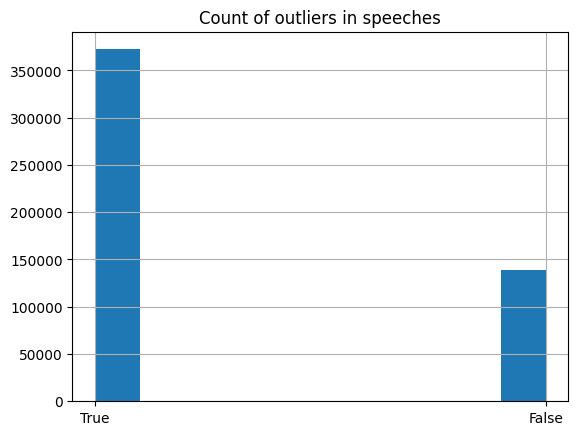

In [24]:
df_sejm['is_outlier'] = (documents_info.Topic == -1).values


h = df_sejm.is_outlier.astype(str).hist()
h.set_title('Count of outliers in speeches') # type: ignore
pass

Widać, że większość wypowiedzi to outliery.


In [26]:
new_topics = topic_model.reduce_outliers(df_sejm.text_all, topics, probabilities=probs, strategy='probabilities')


In [27]:
df_sejm['detected_topic'] = new_topics
df_sejm

,date,author,text_all,place,TextBlob_Subjectivity,TextBlob_Polarity,sentiment_herbert,openai_result,text_part,sentiment,topic,is_outlier,detected_topic
0,2019-11-12,prezydent rzeczypospolitej polskiej andrzej duda,drodzy rodacy! wielce szanowny panie marszałku...,sejm,0.0000,0.0000,1,NaN,NaN,NaN,NaN,True,1
1,2019-11-12,senior antoni macierewicz,bardzo dziękuję panu prezydentowi za tak istot...,sejm,0.0625,-0.0625,1,NaN,NaN,NaN,NaN,True,1
3,2019-11-12,daniel milewski,poseł antoni macierewicz. dziękuję bardzo. pro...,sejm,0.0000,0.0000,1,NaN,NaN,NaN,NaN,True,1
27,2019-11-12,marzena machałek,dziękuję. panie marszałku! wysoka izbo! panie ...,sejm,0.0000,0.0000,1,NaN,NaN,NaN,NaN,True,1
28,2019-11-12,senior antoni macierewicz,"bardzo dziękuję, pani poseł. zanim przejdziemy...",sejm,0.0000,0.0000,0,NaN,NaN,NaN,NaN,True,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1763478,2020-02-06,beata małecka-libera,dziękuję bardzo. oświadczenie w sprawie wpisan...,senat,0.0000,0.0000,1,NaN,NaN,NaN,NaN,True,1
1763480,2020-02-06,jerzy czerwiński,panie marszałku! wysoka izbo! swoje dzisiejsze...,senat,0.0000,0.0000,0,NaN,NaN,NaN,NaN,True,0
1763482,2020-02-06,jerzy czerwiński,kończę myśl. …a następnie o zapewnienie finans...,senat,0.0000,0.0000,0,NaN,NaN,NaN,NaN,True,0
1763484,2020-02-06,marcin bosacki,"dziękuję bardzo, panie marszałku. swoje oświad...",senat,0.5000,0.5000,1,NaN,NaN,NaN,NaN,True,0


In [37]:
pd.DataFrame(df_sejm.detected_topic.value_counts().reset_index())

,index,detected_topic
0,0,314511
1,1,120318
2,2,10214
3,3,8675
4,4,7967
...,...,...
94,94,12
95,95,12
96,96,10
97,97,10


In [45]:
topic_info_df_with_docs_count = topic_info_df.merge(pd.DataFrame(df_sejm.detected_topic.value_counts().reset_index()), how='inner', left_on='Topic', right_on='index')

fig = px.histogram(y=topic_info_df_with_docs_count['Name'], x=topic_info_df_with_docs_count['detected_topic'], orientation='h', title='Histogram of topic occurences',  log_x=True)
fig.update_layout(height=1800)
fig.update_xaxes(title_text='# of Occurences')

# Update y-axis label
fig.update_yaxes(title_text='Topic name')
fig.show()

Obserwacje:

1. Po usunięciu outlierów mamy spore zróżnicowanie w klastrach liczbowo, tj. od najbardziej licznego (314k) do najmniej licznego (10)


In [48]:
print('Final df after reduced outliers:')
topics_array = df_sejm.detected_topic.unique()
topics_array.sort()
for topic in topics_array:
    print()
    topic_info = topic_model.get_topic_info(topic)
    tweets = df_sejm[df_sejm.detected_topic == topic]
    print('Topic: '+topic_info.Name.item() + f"(count: {len(tweets)}, {(len(tweets)*100 / len(df_sejm)):.2f}%)")
    print('Representation: ' + ', '.join(topic_model.get_topic_info(topic).Representation.item()))
    for _, row in df_sejm[df_sejm.detected_topic == topic].sample(10).iterrows():
        print('\t' + row.text_all)

Final df after reduced outliers:

Topic: 0_komisji_senatu_poprawką_poprawkę(count: 314511, 61.49%)
Representation: komisji, senatu, poprawką, poprawkę, poprawce, senat, poprawka, komisja, głosowało, głosowanie
	panie marszałku! wysoka izbo! w nocy z 6 na 7 grudnia w strefie przygranicznej po polskiej stronie zaginęła 4-letnia eileen z iraku. kilkanaście stopni mrozu. dziewczynka wraz z rodzicami i grupą dorosłych przekroczyła polską granicę z nadzieją na bezpieczne schronienie w europie. pomimo złego stanu zdrowia rodzice eileen zostali wywiezieni na teren białorusi. strażnicy mieli świadomość, w jak nieludzkich warunkach migranci zmuszeni są wegetować po białoruskiej stronie. mimo to rodzinie dziewczynki nie udzielono pomocy. fakty: 15 stopni mrozu, brak pomocy, narażenie migrantek i migrantów na przemoc na białorusi. to wszystko stanowi bezpośrednie zagrożenie dla zdrowia i życia. dziewczynka po raz ostatni widziana była po polskiej stronie w okolicach nowego dworu. według doniesień 

Obswerwacje:

1. Spojrzenie na pierwsze w kolejności numerycznej klastry wskazuje, że spora liczba wypowiedzi została zakwalifikowana do klastra 0 (ponad 60%), bardzo niejednorodnego pod kątem tematyki wypowiedzi, które są w nim obecne.
2. Inne klastry o mniejszej liczności prezentują raczej zrozumiałe dla człowieka powiązania między słowami kluczowymi w klastrze a treścią wypowiedzi - te klastry można wykorzystać jako propozycje wypowiedzi do dalszej analizy. Liczność wypowiedzi również wydaje się być tutaj małą przeszkodą, gdyż jest ona rzędu $10^{3}$


# Obserwacje z całego notebooka

1. Wysokie niezbalansowanie licznościowe tematów może być powodem słabych analiz w kolejnym kroku, ze względu na mało przykładów wspierających nawet pojedyncze, izolowane tematy
2. Niektóre tematy proponowane przez algorytm są zrozumiałe i interpretowalne (np. alkohol, wojsko, podatki), niektóre nie (np. temat 0)

# Propozycje działania

1. Zserializujmy model BERTopic dla sejmu do ewentualnego ponownego użycia
2. Skorzystajmy, że wszystkie wypowiedzi zostały przypisane do tematów i stwórzmy pomocniczy dataframe, w którym te przypisania będą podane
3. Do analizy stance nie musimy brać wszystkich tematów, możemy wziąć tylko takie, które spełniają wybrane przez nas kryteria, propozycje takich kryteriów:
   1. Wystarczająca liczba wypowiedzi na dany temat
   2. Wystarczająco homogeniczny temat pod względem treści
   3. Wystarczająco dobrze oceniona przez nas jakość przypisania na bazie oceny próbek losowych tekstów


In [49]:
topic_model.save('./bertopic_results/sejm/model', serialization="pytorch", save_ctfidf=True)

df_sejm.to_csv('./bertopic_results/sejm/sejm_bertopic_annotated.csv', index_label=False)